# Step 1: Linking Google Drive to Colab

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# Step 2: Constants

In [0]:
DATA_PATH = 'drive/My Drive/cat_and_dog_images/'
TRAINING_DATA_PATH = 'drive/My Drive/cat_and_dog_images/dataset/training_set'
TESTING_DATA_PATH = 'drive/My Drive/cat_and_dog_images/dataset/test_set'
PREDICTION_DATA_PATH = 'drive/My Drive/cat_and_dog_images/predict/'

# Step 3: Test displaying Image

In [3]:
from PIL import Image
dog = Image.open("drive/My Drive/cat_and_dog_images/dataset/training_set/dogs/dog.10.jpg")
dog.size

(269, 292)

# Step 4: Importing Libraries

In [0]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Step 5: Building the CNN

In [5]:
# Initialize the CNN:
classifier = Sequential()

# Step 1: Convolution
classifier.add(Conv2D(32,(3,3),input_shape=(64,64,3),activation='relu'))

# Step 2: Pooling
classifier.add(MaxPooling2D(pool_size=(2,2)))

# Step 3: Flattening
classifier.add(Flatten())

# Step 4: Full Connection
classifier.add(Dense(units=128, activation='relu'))
classifier.add(Dense(units=1,activation='sigmoid'))

# Compile the CNN
classifier.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
               
            







Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [6]:
# Fitting image to CNN
from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1/255, shear_range=0.2, zoom_range=0.2,
                                  horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1/255)

training_set = train_datagen.flow_from_directory(TRAINING_DATA_PATH, target_size=(64,64),
                                                batch_size=32, class_mode='binary')

test_set = test_datagen.flow_from_directory(TESTING_DATA_PATH, target_size=(64,64),
                                            batch_size=32, class_mode='binary')

Found 8000 images belonging to 2 classes.
Found 2000 images belonging to 2 classes.


In [17]:
classifier.fit_generator(training_set,steps_per_epoch=8000/32, epochs=25, validation_data=test_set, validation_steps=2000/32)

Epoch 1/25
250/250 [==============================] - 76s 303ms/step - loss: 0.5136 - acc: 0.7457 - val_loss: 0.5421 - val_acc: 0.7405
Epoch 2/25
250/250 [==============================] - 73s 292ms/step - loss: 0.4964 - acc: 0.7550 - val_loss: 0.5379 - val_acc: 0.7550
Epoch 3/25
250/250 [==============================] - 74s 297ms/step - loss: 0.4968 - acc: 0.7581 - val_loss: 0.5283 - val_acc: 0.7540
Epoch 4/25
250/250 [==============================] - 74s 295ms/step - loss: 0.4907 - acc: 0.7582 - val_loss: 0.5329 - val_acc: 0.7530
Epoch 5/25
250/250 [==============================] - 74s 297ms/step - loss: 0.4904 - acc: 0.7619 - val_loss: 0.5242 - val_acc: 0.7515
Epoch 6/25
250/250 [==============================] - 74s 295ms/step - loss: 0.4815 - acc: 0.7618 - val_loss: 0.5311 - val_acc: 0.7500
Epoch 7/25
250/250 [==============================] - 73s 294ms/step - loss: 0.4811 - acc: 0.7663 - val_loss: 0.5287 - val_acc: 0.7635
Epoch 8/25
250/250 [==============================] - 7

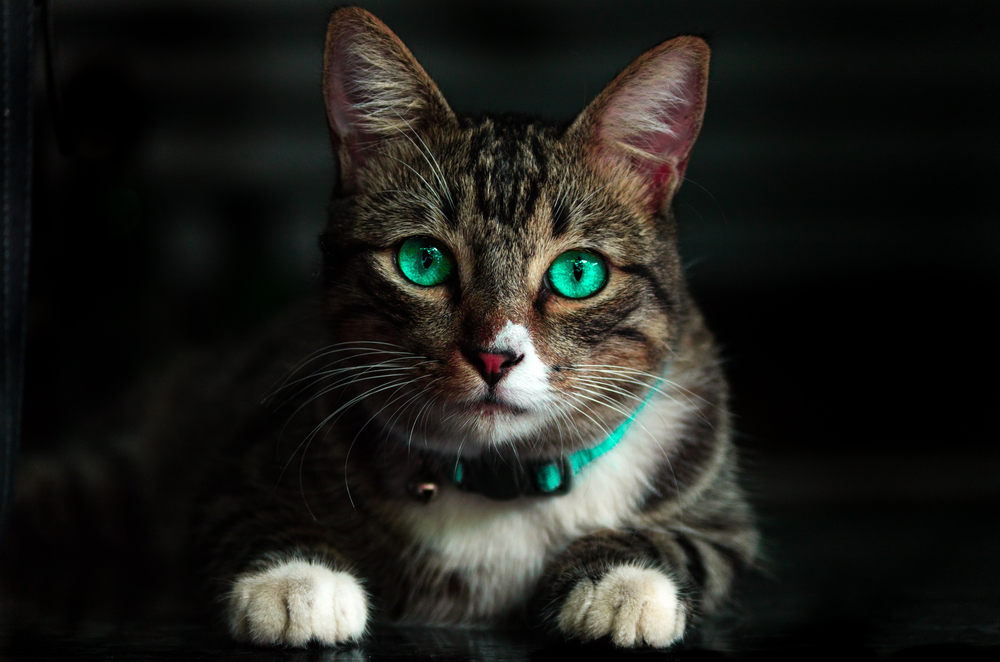

cat


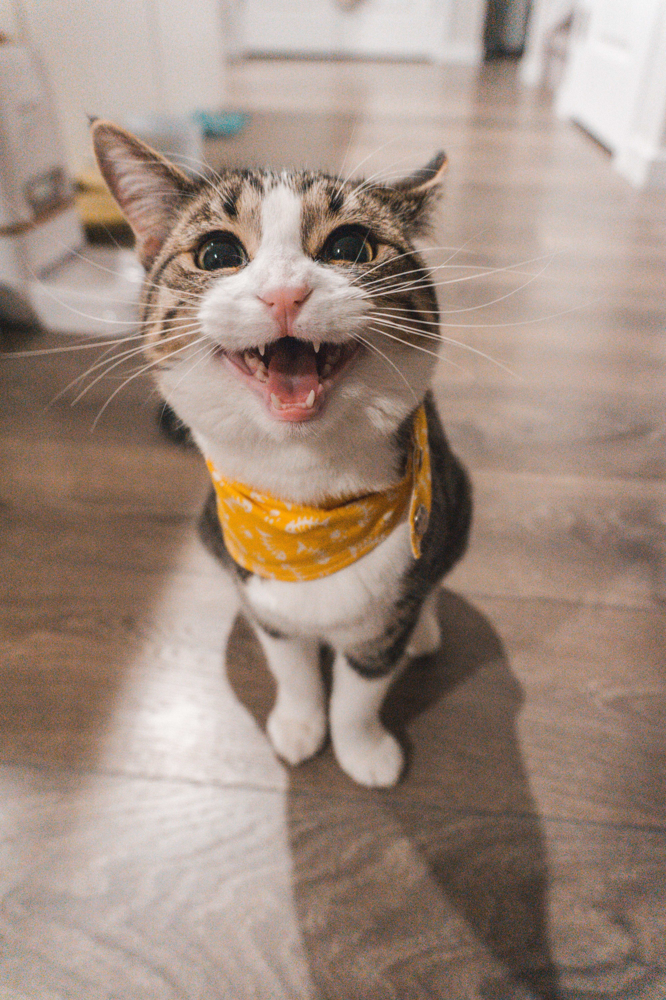

dog


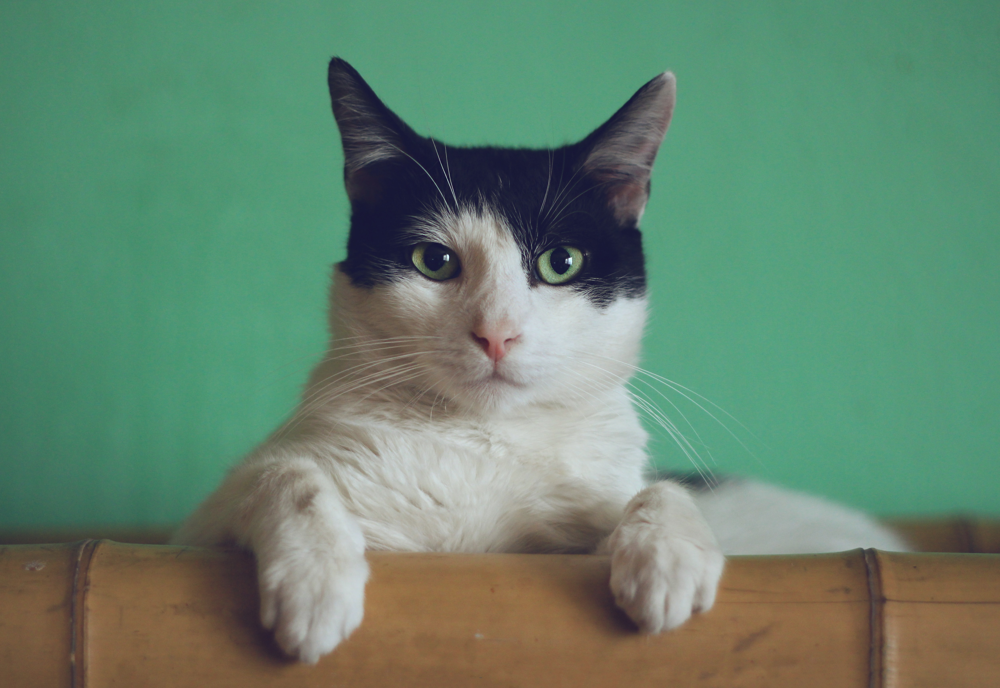

cat


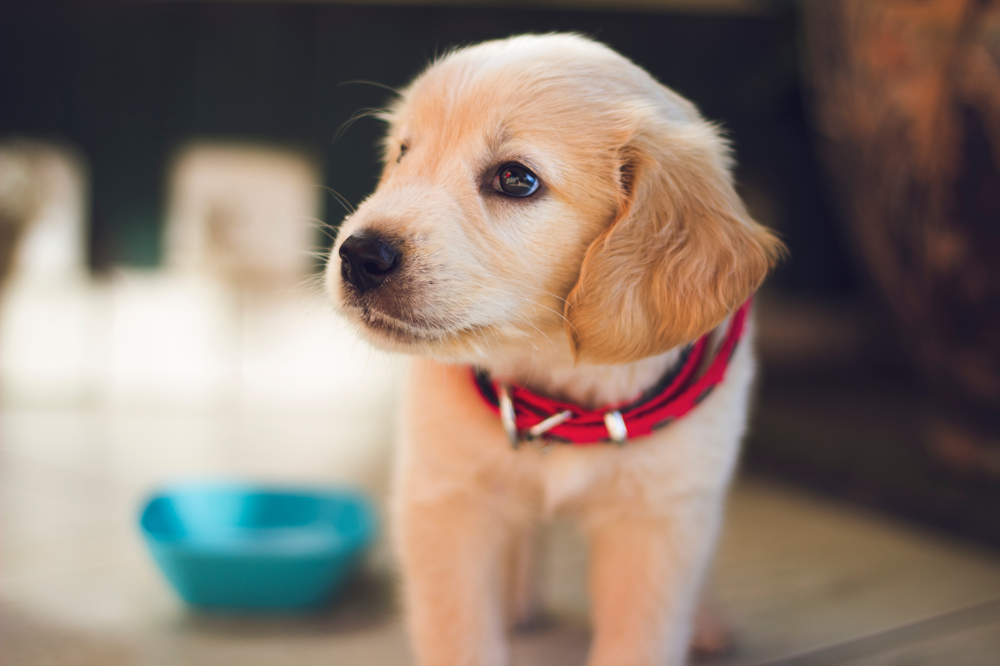

dog


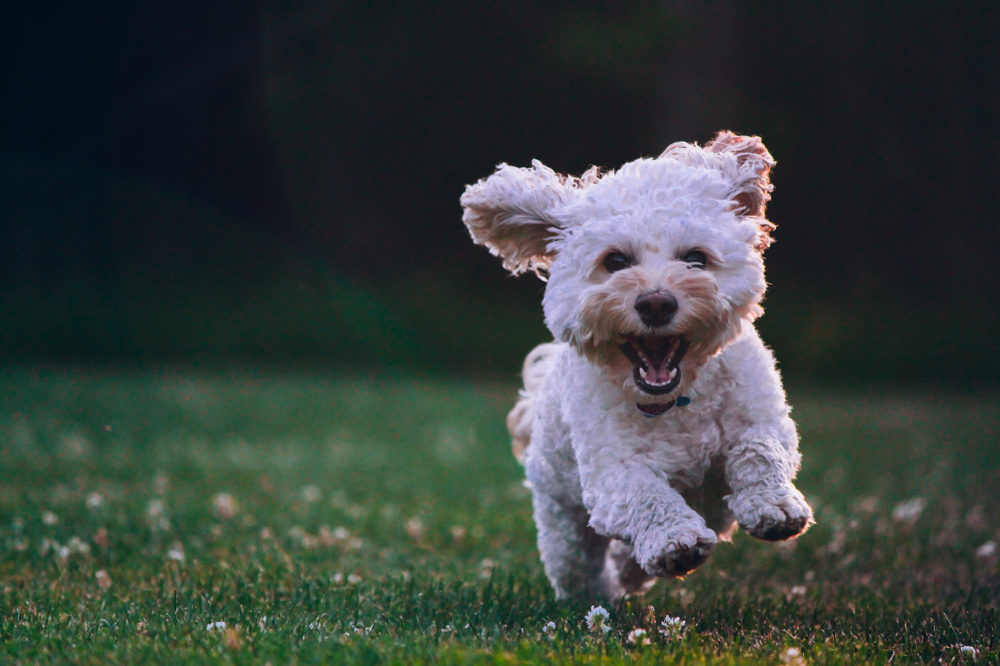

dog


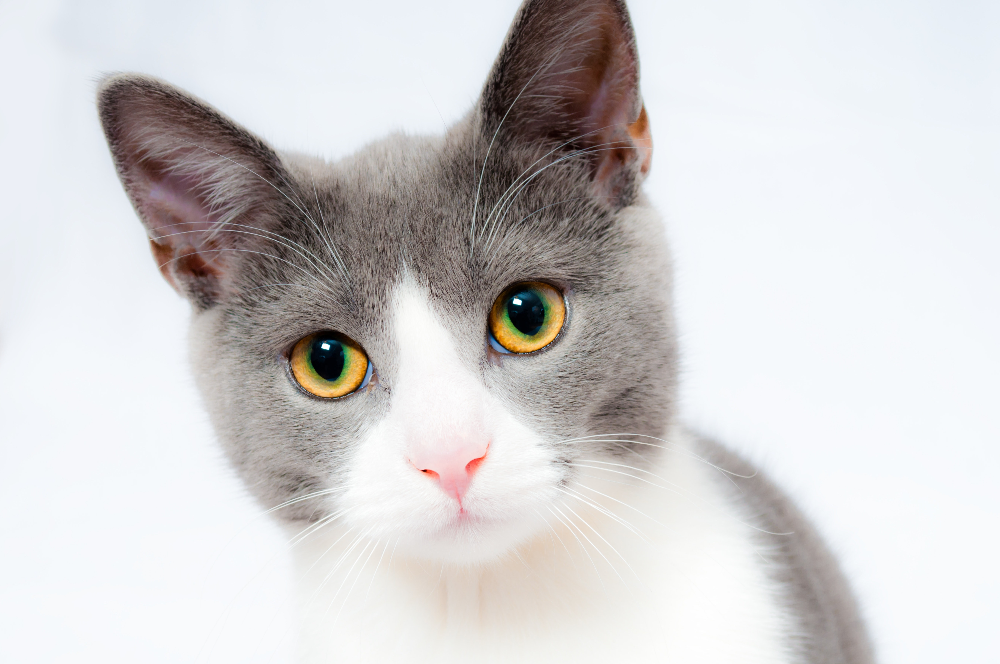

cat


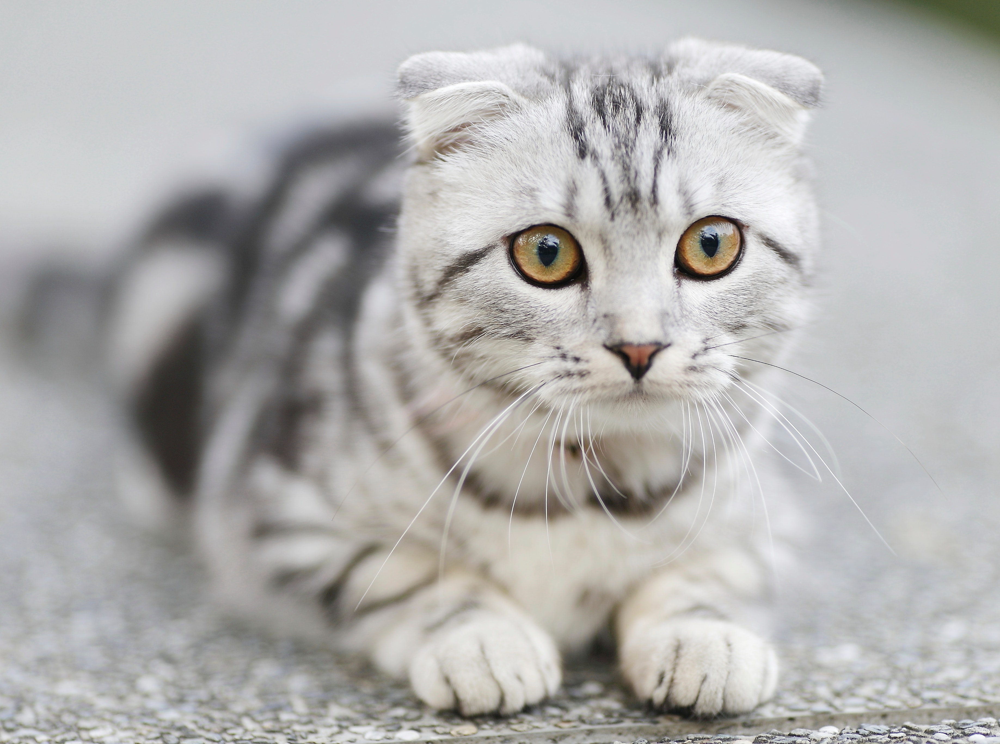

cat


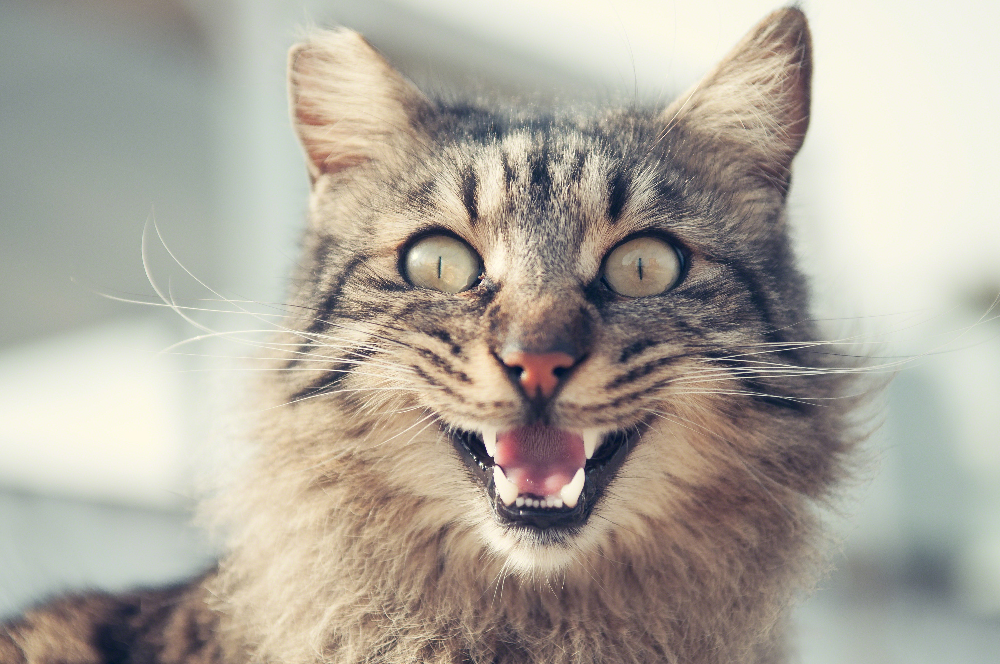

cat


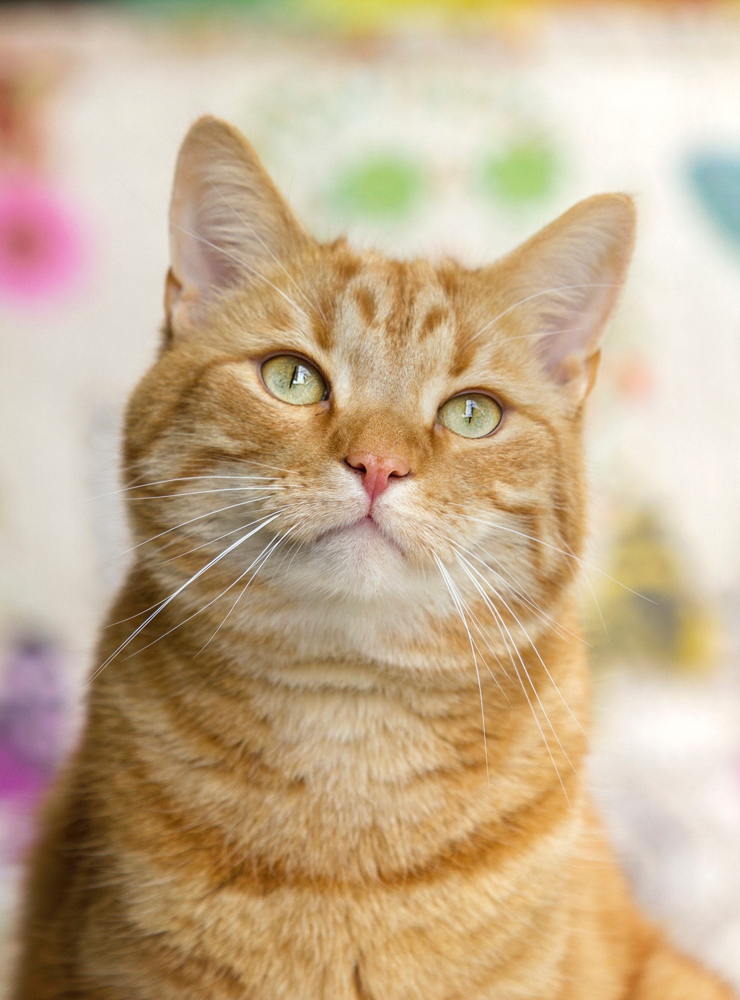

cat


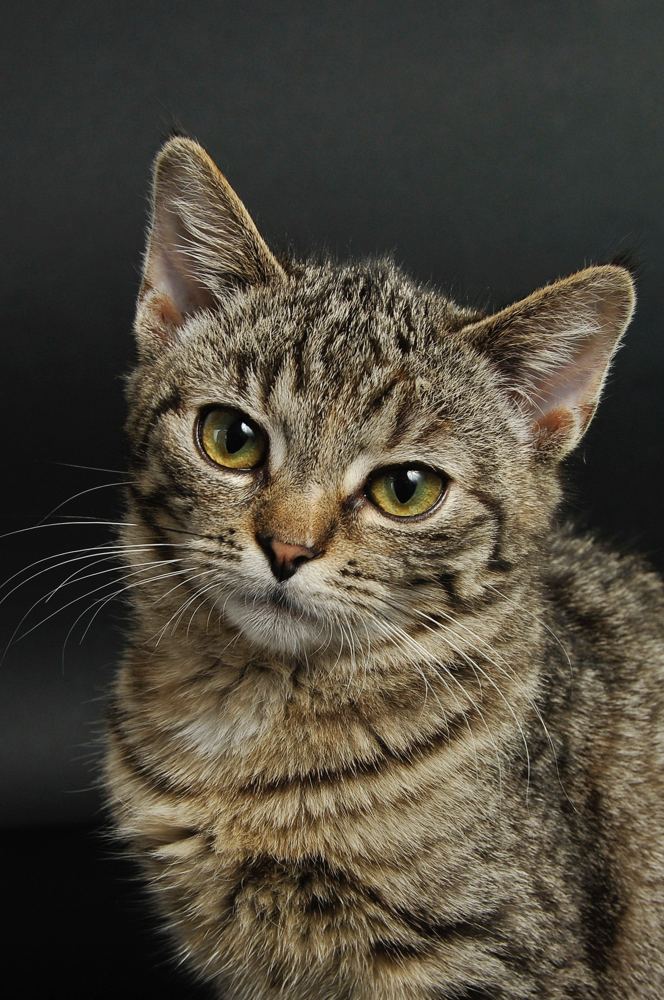

dog


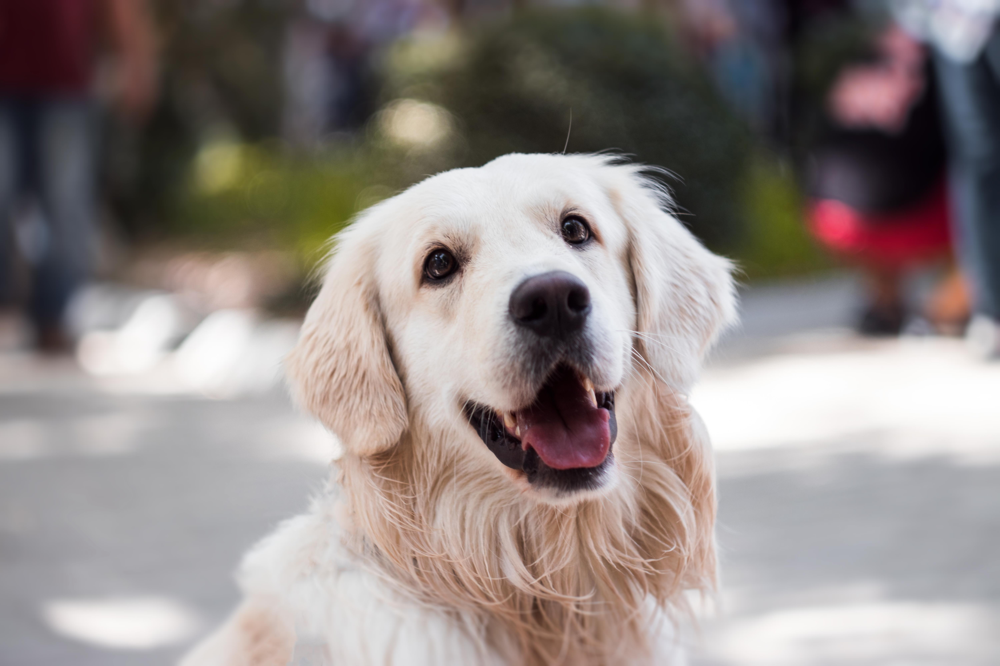

dog


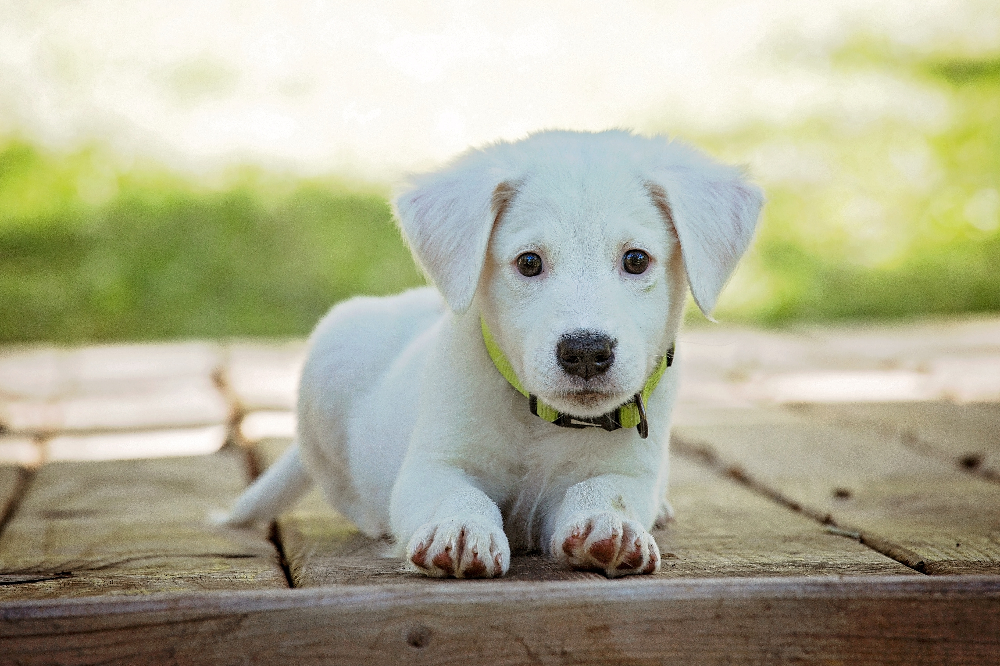

dog


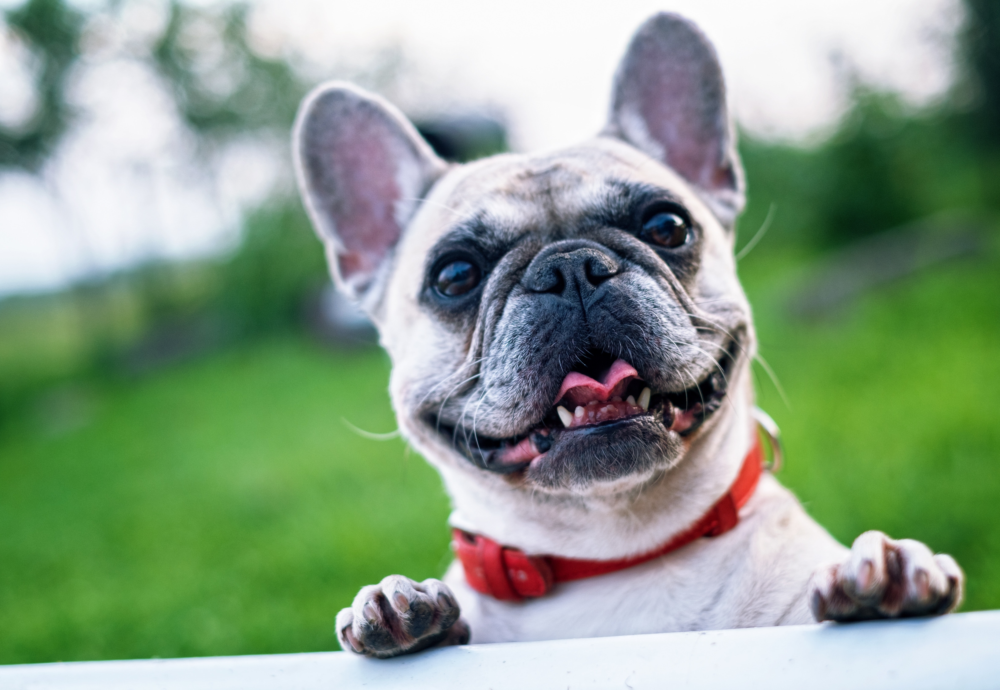

dog


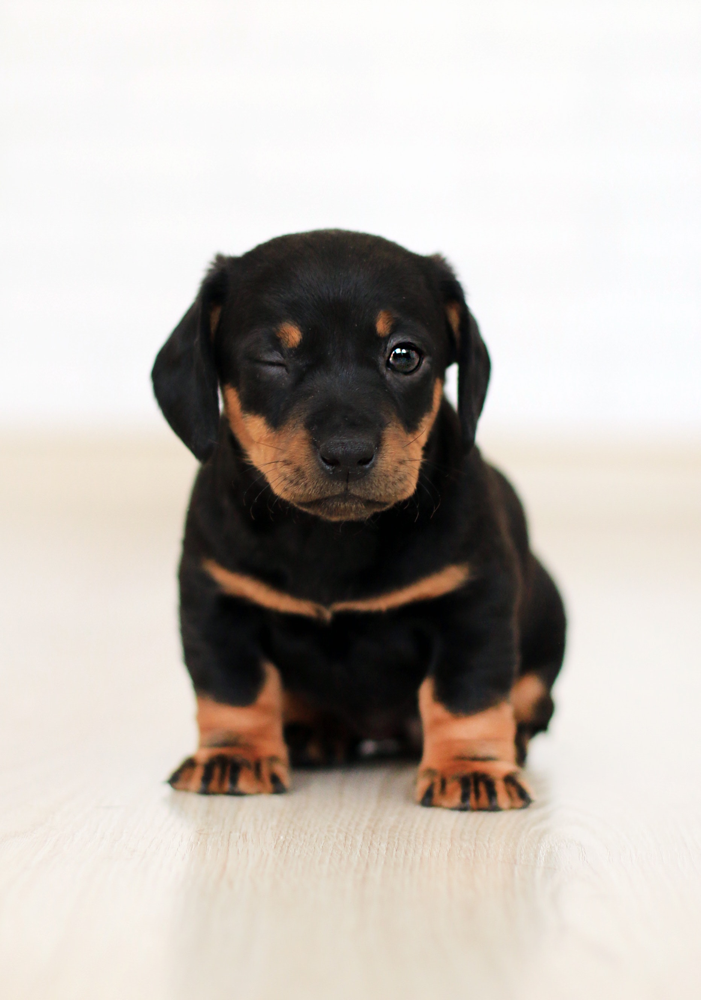

dog


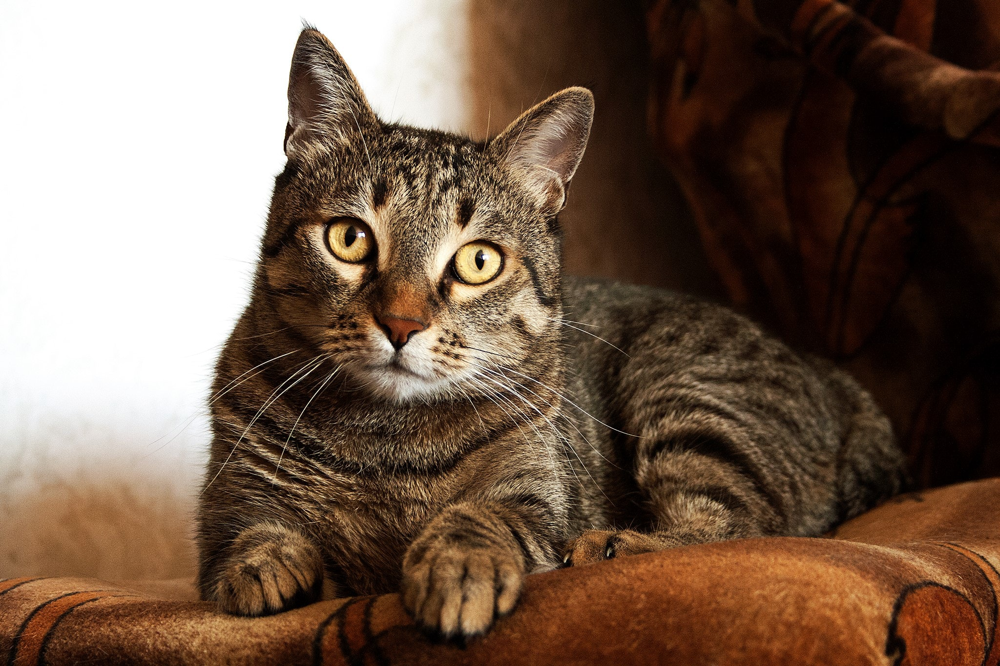

dog


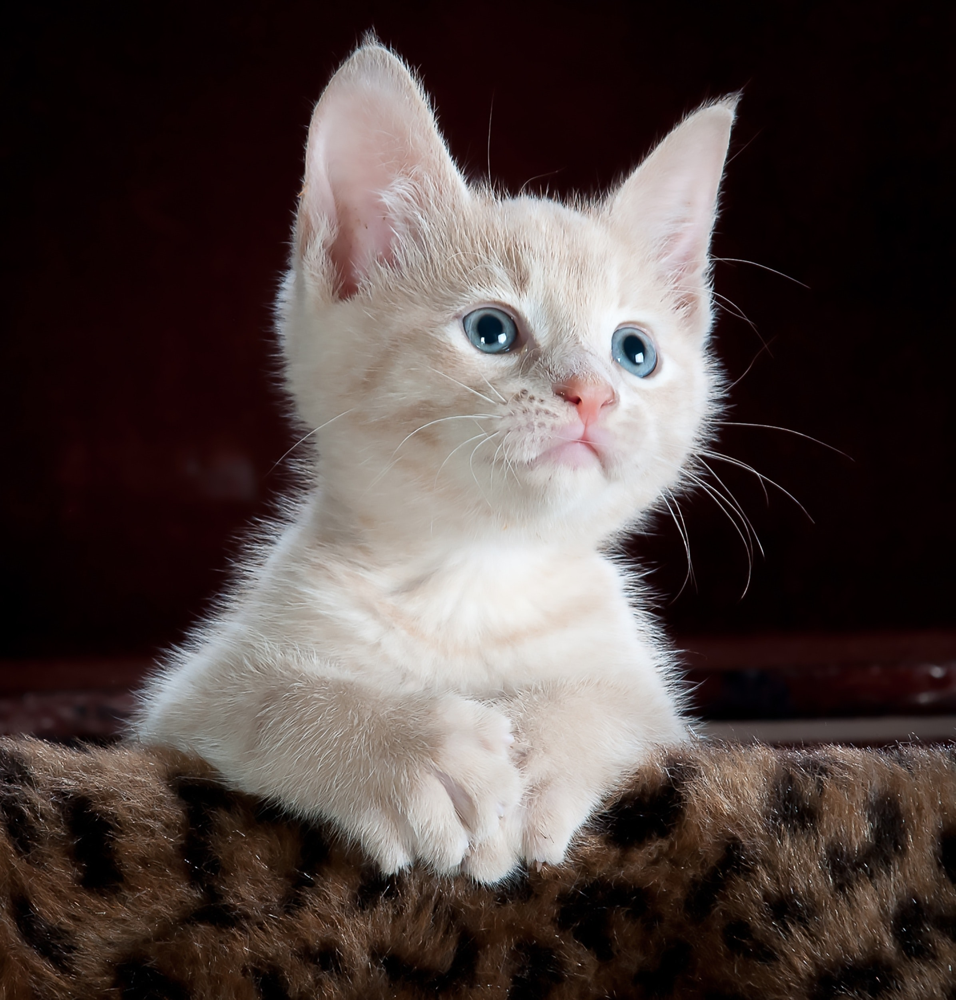

cat


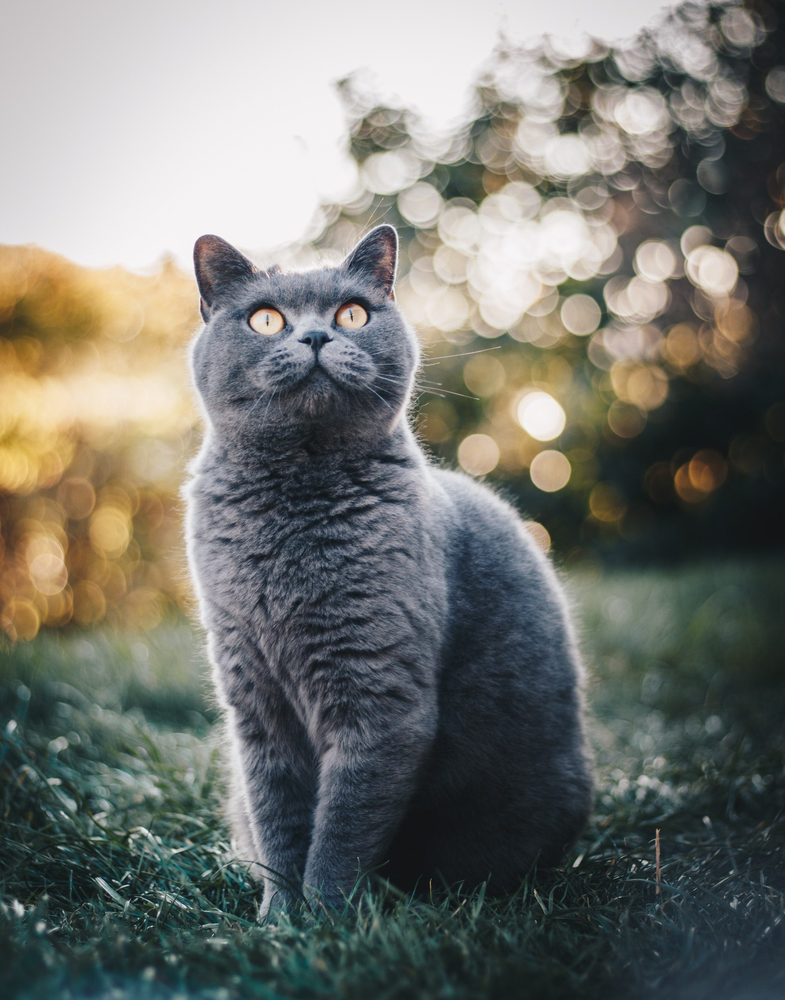

dog


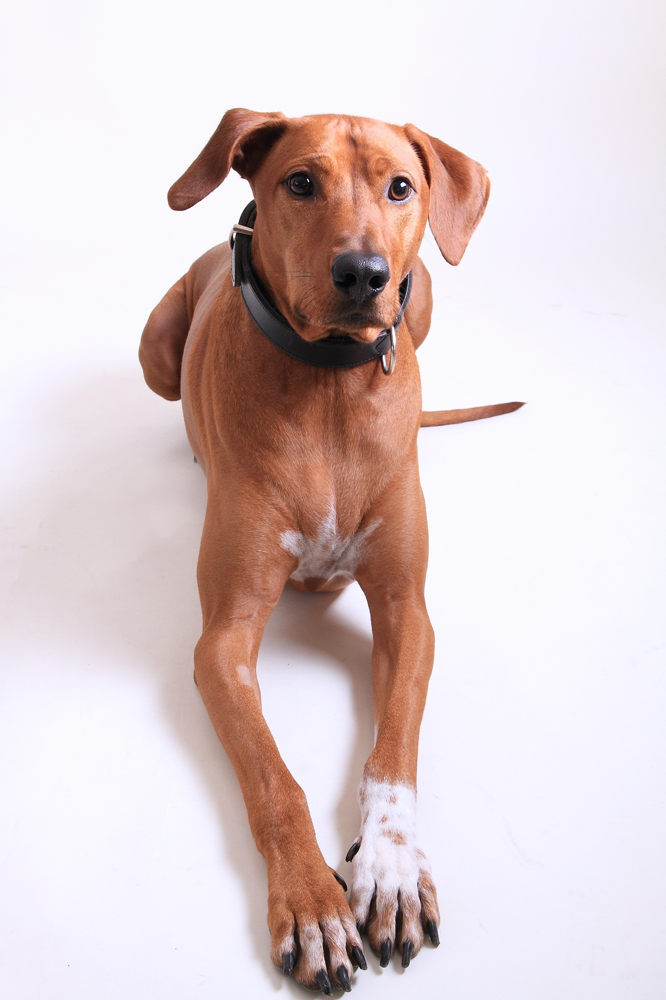

dog


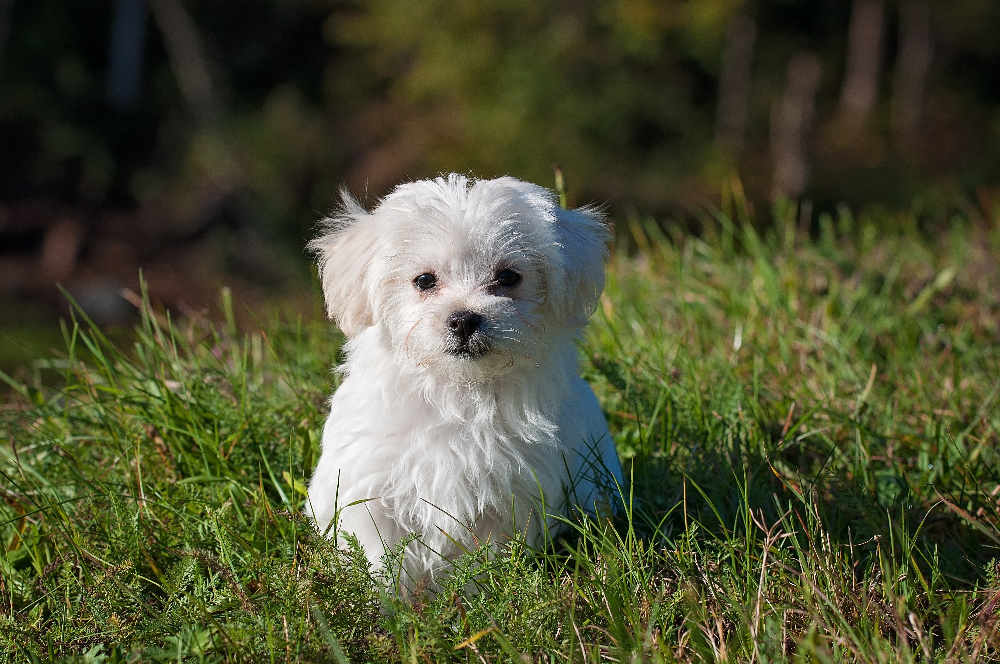

dog


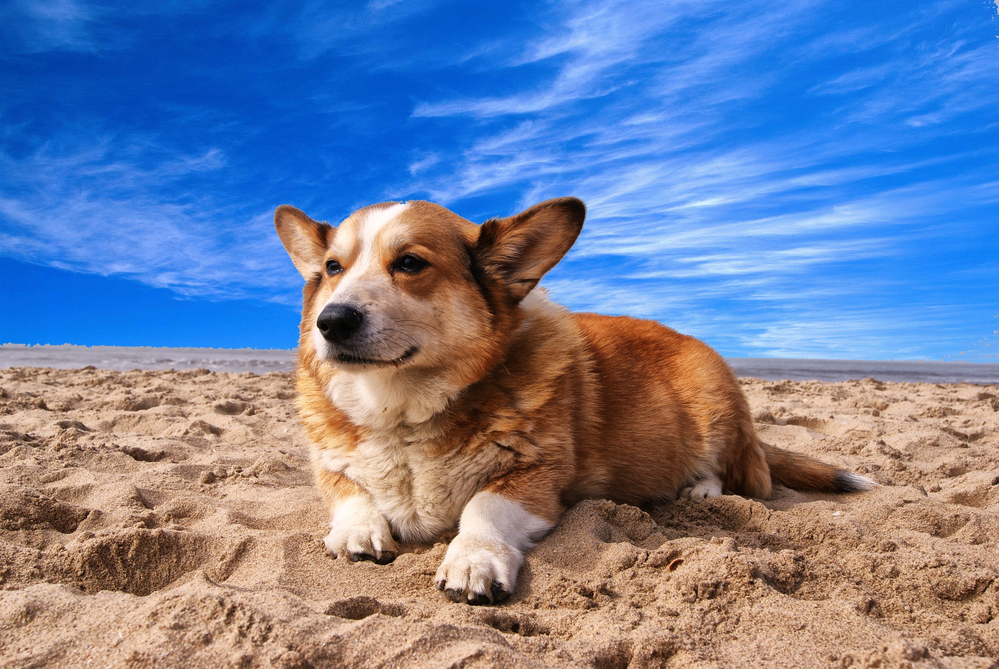

dog


In [25]:
PREDICTION_DATA_PATH = 'drive/My Drive/cat_and_dog_images/predict/'

# Part 3 - Making new predictions
import numpy as np
from keras.preprocessing import image
from IPython.display import Image, display

for i in range(1,21):
  test_image = image.load_img(PREDICTION_DATA_PATH + f'{i}.jpg', target_size = (64, 64))
  display(Image(PREDICTION_DATA_PATH + f'{i}.jpg',width=100, height=100))
  test_image = image.img_to_array(test_image)
  test_image = np.expand_dims(test_image, axis = 0)
  result = classifier.predict(test_image)
  training_set.class_indices
  if result[0][0] == 1:
    prediction = 'dog'
  else:
    prediction = 'cat'
  print(prediction)